# 분기별 인기상품 트렌드 확인
- 1분기 : 1월 ~ 3월
- 2분기 : 4월 ~ 6월
- 3분기 : 7월 ~ 9월
- 4분기 : 10월 ~ 12월

- X - 분기 / Y - 물품판매수 / color - 물품대분류

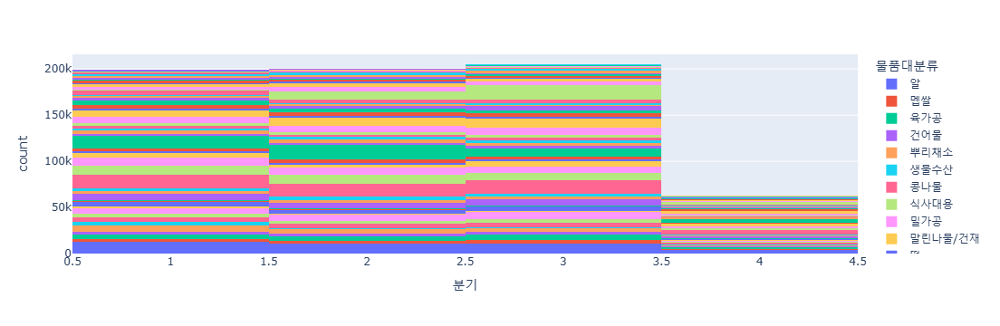

In [93]:
def get_quarter(x) :
    if x <= 3 :
        return 1
    elif x >= 4 and x <= 6 :
        return 2
    elif x >= 7 and x <= 9 :
        return 3
    else :
        return 4

# df_sales_quarter데이터 프레임 생성
df_sales_quarter = df_sales

# '분기' 파생변수 생성
df_sales_quarter['분기'] = df_sales_quarter['주문일시_month'].apply(get_quarter)

# 분석에 필요한 '분기'와 '제품번호'만 뽑기
df_sales_quarter = df_sales_quarter[['분기', '제품번호']]

# 병합
df_merged_quarter = df_sales_quarter.merge(df_product, on='제품번호', how='inner')

# 분기별 인기상품 시각화 (X - 분기 / Y - 물품판매수 / color - 물품대분류)
px.histogram(df_merged_quarter, x='분기', color = '물품대분류')

# 각 분기별 인기상품 트렌드 확인
- seaborn 라이브러리
- 그래프 이미지파일로 저장O

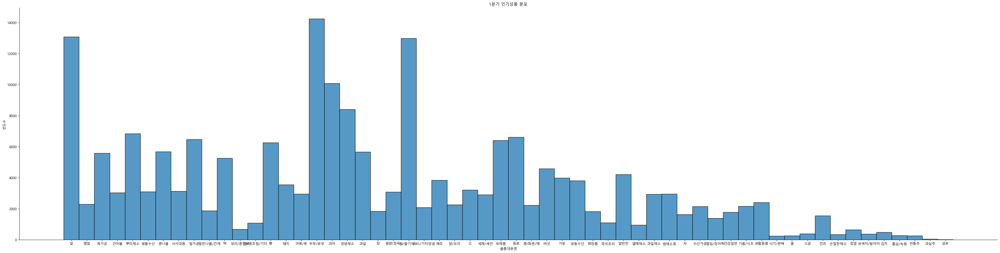

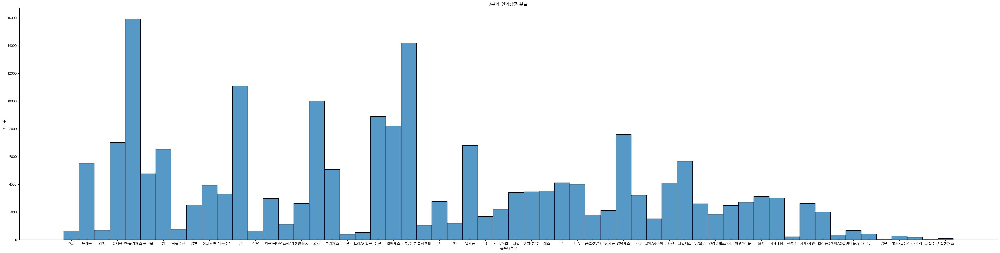

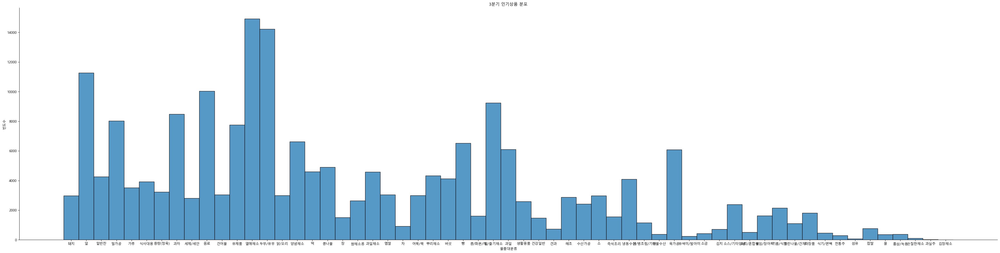

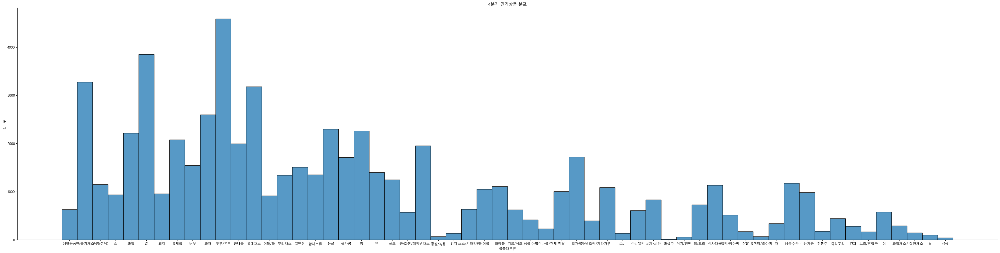

In [102]:
# 분기별 필터 생성
quarter1_cond = df_sales['주문일시_month'] <= 3
quarter2_cond = (df_sales['주문일시_month'] >= 4) & (df_sales['주문일시_month'] <= 6)
quarter3_cond = (df_sales['주문일시_month'] >= 7) & (df_sales['주문일시_month'] <= 9)
quarter4_cond = df_sales['주문일시_month'] >= 10

for quarter in range(1, 5) :
    # 분기별 필터링
    if quarter == 1 :
        df_quarter = df_sales.loc[quarter1_cond]
    elif quarter == 2 :
        df_quarter = df_sales.loc[quarter2_cond]
    elif quarter == 3 :
        df_quarter = df_sales.loc[quarter3_cond]
    else :
        df_quarter = df_sales.loc[quarter4_cond]

    # 분석에 필요한 '제품번호'와 '주문일시_month'만 남기기
    df_quarter = df_quarter[['제품번호', '주문일시_month']]

    # 병합
    df_merged_each_quarter = df_quarter.merge(df_product, on='제품번호', how='inner')

    # 각 분기별 인기상품 시각화
    sns.displot(data = df_merged_each_quarter, x = '물품대분류', height=10, aspect=4)
    plt.xlabel('물품대분류')
    plt.ylabel('빈도수')
    plt.title(f'{quarter}분기 인기상품 분포')

    # 그래프 이미지파일로 저장
    plt.savefig(f'{quarter}분기_popular_products_image.png')

# 각 분기별 물품중분류 별 인기상품 트렌드 확인
- 분기 입력받아 plotly 라이브러리로 시각화
- 각 분기별 물품대분류 판매 개수 그래프에 물품중분류 중첩하여 시각화
- 입력한 분기에 해당하는 물품대분류 및 물품중분류 별 상품 판매 수 출력

분기를 입력하시오 : 1


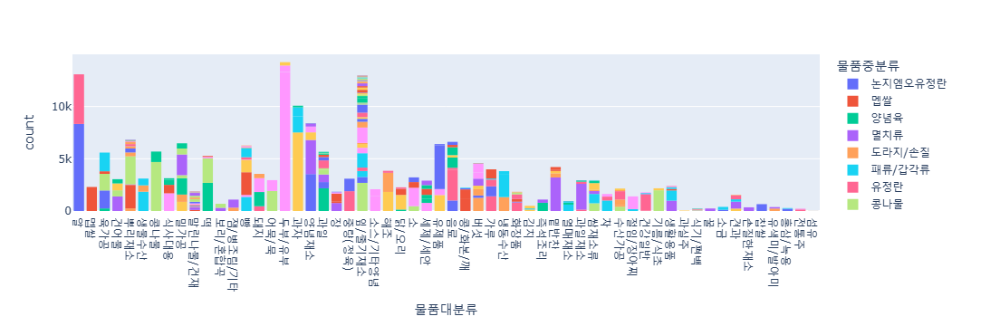

In [109]:
quarter = int(input("분기를 입력하시오 :"))
quarter_cond = df_sales_quarter['분기'] == quarter

# 입력에 해당하는 분기만 필터
df_quarter = df_sales_quarter.loc[quarter_cond]

# 분석에 필요한 '제품번호'와 '분기'만 남기기
df_quarter = df_quarter[['제품번호', '분기']]

# df_quarter df_product 병합
df_merged_quarter = df_quarter.merge(df_product, on='제품번호', how='inner')

# 각 분기별 인기상품 시각화 (X - 물품대분류 / Y - 월별판매개수 / color = 물품중분류)
px.histogram(df_merged_quarter, x='물품대분류', color = '물품중분류')

# 고객 유형별 인기상품 분석

1. 회원 RFM 점수별 인기상품

2. 고객 연령대 별 인기상품